# 24시간 응급체계를 위한 실외 AED 위치 선정

In [2]:
import pandas as pd
import time
import base64
import re
import pickle
import matplotlib.pyplot as plt
plt.rc('font', family='NanumBarunGothic')
from datetime import datetime
import geopandas as gpd
import pydeck as pdk
from shapely import wkt
from tqdm import tqdm
from mip import *
from typing import Any
import os 
os.chdir('/home/jihwanyoon/Data_Science_Festival_2022')
from utils.util import *

# 지도에 표시할 AED 아이콘 불러와서 저장하기
# https://www.flaticon.com/kr/authors/kanyanee-watanajitkasem
AED_ICON = 'assets/free-icon-aed-6417086.png'
icon = image_to_data_url(AED_ICON)
icon_data = {
    "url": icon,
    "width": 128,
    "height": 128,
    "anchorY": 128,
}

# 동대문구 행동별 경계면 폴리곤 데이터 
with open('data/seoul_boundary.pickle', 'rb') as f:
    boundary = pickle.load(f)

boundary = boundary[boundary['구'] == '동대문구']

# EDA

## 1. 성별, 연령대별 심정지 발생 현황 

### 1-1) 성별 심정지 발생 현황
- 사용 데이터 : 전체_발생건수.csv
- 급성심장정지조사의 전국 심정지 환자 발생 데이터(2019)를 활용한 시각화
- 남성이 65.2%, 여성이 34.8%로 남성이 여성보다 2배에 가깝게 많이 발생

In [3]:
occur = pd.read_csv("data/전체_발생건수.csv", encoding='cp949')
seoul = occur[occur['시도별(1)'] == '서울']
seoul = seoul.drop([seoul.index[3], seoul.index[-1]])
sper = seoul.T[2::2]
sper

,15,16,17,19,20,21,22,23,24,25,26,27
성별 및 연령별(2),소계,남자,여자,0~9세,10~19세,20~29세,30~39세,40~49세,50~59세,60~69세,70~79세,80세 이상
2012.1,15.0,64.2,35.8,1.3,1.0,3.0,5.6,8.9,17.5,16.8,23.7,22.3
2013.1,15.7,64.4,35.5,1.4,1.3,3.0,5.5,8.6,17.0,16.6,23.4,23.1
2014.1,16.1,62.5,37.4,1.1,1.1,2.4,5.0,8.0,15.7,16.4,24.1,25.9
2015.1,15.6,63.8,36.1,1.2,1.2,2.9,4.7,8.6,15.0,15.9,25.1,25.2
2016.1,15.3,63.5,36.5,1.1,0.8,3.1,4.5,9.1,15.3,16.6,24.8,24.7
2017.1,15.6,65.7,34.3,0.8,0.9,2.9,4.3,8.5,15.4,17.3,24.6,25.3
2018.1,15.4,64.4,35.6,1.0,1.3,2.4,4.0,8.1,14.2,17.4,24.4,27.2
2019.1,14.4,65.2,34.8,1.1,1.1,3.1,3.8,7.0,14.1,17.7,23.9,28.1


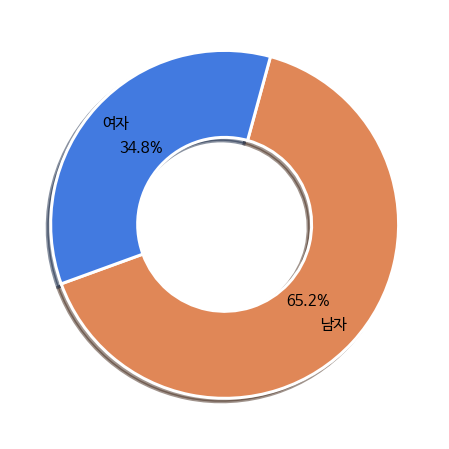

In [4]:
ratio = list(sper.iloc[-1, 1:3].astype(float))
labels = list(sper.iloc[0, 1:3])
plt.figure(figsize=(8,8))

patches, texts, autotexts = plt.pie(ratio, labels=labels, 
                                    autopct='%1.1f%%', 
                                    shadow=True, 
                                    startangle=200,
                                    pctdistance = 0.65,
                                    labeldistance = 0.85,
                                    colors = ['#E08757', '#427AE0'],
                                    wedgeprops = {'width':0.5,'edgecolor':'w','linewidth':3},
                                    textprops = {'size' : 15}
                                    )
# Customize text labels
for text in texts:
    text.set_horizontalalignment('center')

# Customize percent labels
for autotext in autotexts:
    autotext.set_horizontalalignment('center')
    autotext.set_fontstyle('italic')

plt.show()

### 1-2) 연령대 별 심정지 발생 현황
- 80세 이상이 28.1%, 70대가 23.9%, 60대가 17.7%로 나이대가 높을수록 전체 심정지 환자에서 많은 비율을 차지한다.
- 50세 이상이 전체의 84%를 차지한다.
- 나이대에 따라 심정지 발생률이 확실히 다르므로 심정지 발생 예상인구 추측에 고려해야한다.

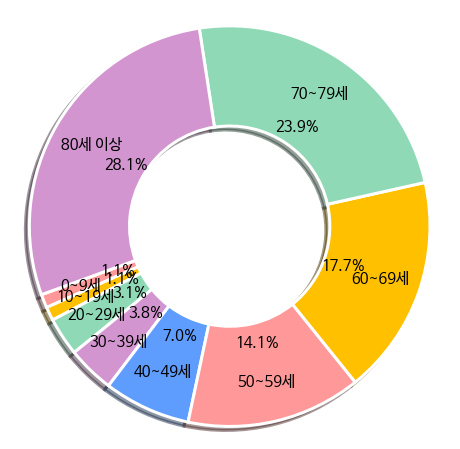

In [5]:
import matplotlib.pyplot as plt
ratio = list(sper.iloc[-1, 3:].astype(float))
labels = list(sper.iloc[0, 3:])

# Plot
plt.figure(figsize=(8,8))
patches, texts, autotexts = plt.pie(ratio, labels=labels, 
                                    autopct='%1.1f%%', 
                                    shadow=True, 
                                    startangle=200,
                                    pctdistance = 0.6,
                                    labeldistance = 0.8,
                                    colors = ['#ff9999', '#ffc000', '#8fd9b6', '#d395d0', '#5E9DFD'],
                                    wedgeprops = {'width':0.5,'edgecolor':'w','linewidth':3},
                                    textprops = {'size' : 15}
                                    )
# Customize text labels
for text in texts:
    text.set_horizontalalignment('center')

# Customize percent labels
for autotext in autotexts:
    autotext.set_horizontalalignment('center')
    autotext.set_fontstyle('italic')

plt.axis('equal')
plt.show()

## 2. 인구 데이터 - 동별 인구 수요량(a)
- 사용 데이터 : 동대문구_동별_연령대별_인구수.csv
- 동대문구의 동별로 성별, 나이대별 인구 데이터에 2020년 급성심장정지 조사에서 발표한 전국 성별, 나이대별 심정지 발생 비율을 weighted sum해서 구함

In [6]:
pop = pd.read_csv('data/동대문구_동별_연령대별_인구수.csv')

cols = pop.columns
pop['male'] = pop[cols[2]] * 0.01 + pop[cols[3]] * 0.026 + pop[cols[4]] * 0.039 + pop[cols[5]] * 0.075 + pop[cols[6]] * 0.139 + pop[cols[7]] * 0.7
pop['male'] = pop['male'] / pop['male'].max()
pop['female'] = pop[cols[8]] * 0.01 + pop[cols[9]] * 0.026 + pop[cols[10]] * 0.039 + pop[cols[11]] * 0.075 + pop[cols[12]] * 0.139 + pop[cols[13]] * 0.7
pop['female'] = pop['female'] / pop['female'].max()
pop['a'] = 0.64 * pop['male'] + 0.36 * pop['female']
pop.head(5)

,행정동코드명,총상주인구수,남성연령대10상주인구수,남성연령대20상주인구수,남성연령대30상주인구수,남성연령대40상주인구수,남성연령대50상주인구수,남성연령대60이상상주인구수,여성연령대10상주인구수,여성연령대20상주인구수,여성연령대30상주인구수,여성연령대40상주인구수,여성연령대50상주인구수,여성연령대60이상상주인구수,male,female,a
0,용신동,30305,1543,2695,2733,2353,2536,3708,1397,2743,2406,1966,2221,4004,0.489269,0.461159,0.479149
1,제기동,24837,1317,2261,1882,1768,2039,3444,1221,1886,1515,1463,1908,4133,0.438450,0.454489,0.444224
2,전농동,50674,3743,3609,3585,3987,4181,5896,3741,3494,3423,3897,4184,6934,0.778669,0.803372,0.787562
3,답십리동,58632,4519,3879,4888,4702,4651,6002,4317,4060,4980,4494,4837,7303,0.816840,0.867090,0.834930
4,장안동,69413,5685,4439,5652,6117,5422,7391,5249,4365,5474,5751,5460,8408,1.000000,1.000000,1.000000


## 3. 도보 노드-링크 데이터(후보지 데이터)

### 3-1) 노드 데이터
- 후보지 및 수요지로 사용할 도보 노드 데이터 생성

- 사용 데이터 : 서울시 자치구별 도보 네트워크 공간정보.csv
- 육교와 횡단보도에 설치하지 않을 예정이므로 제외
- 수요량 b 생성을 위한 100m buffer와 시각화를 위한 200m(유효거리) buffer 생성
-  buffer를 두 개 컬럼으로 생성할 경우 오류가 생겨 df_dobo_100과 df_dobo_200으로 나눔

In [7]:
df = pd.read_csv('data/서울시 자치구별 도보 네트워크 공간정보.csv', encoding='cp949')

df = df[(df['노드링크 유형'] == 'NODE') &
        (df['시군구명'] == '동대문구') &
        (df['육교'] == 0) &
        (df['횡단보도'] == 0)]

# 용두동 + 신설동 = 용신동
df.loc[(df['읍면동명'] == "용두동") |
         (df['읍면동명'] == "신설동"), "읍면동명"] = "용신동"
df = df[['노드 WKT', '노드 ID', '시군구명', '읍면동명']].reset_index(drop=True)

In [8]:
def create_buffer(df: pd.DataFrame, pop: pd.DataFrame, buffer_dist: int) -> gpd.GeoDataFrame:
    """
    주어진 DataFrame(df)와 인구 데이터프레임(pop)을 기반으로 특정 거리(buffer_dist) 내의 버퍼를 생성하고
    해당 버퍼에 대응하는 행정 구역의 인구를 병합한 후, 병합된 데이터프레임을 반환하는 함수
    
    Args:
        df (pd.DataFrame): 노드 좌표가 들어 있는 DataFrame. '노드 WKT'와 '읍면동명' 열을 포함
        pop (pd.DataFrame): 행정동별 인구수 정보가 있는 DataFrame. '행정동코드명'과 'a'(인구수) 열을 포함
        buffer_dist (int): 버퍼를 생성할 거리(미터 단위).
        
    Returns:
        df_dobo (gpd.GeoDataFrame): 버퍼와 인구 데이터가 병합된 GeoDataFrame.
    """
    
    # WKT 형식의 노드 좌표를 GeoSeries로 변환
    gs = gpd.GeoSeries.from_wkt(df['노드 WKT'])
    
    # DataFrame을 GeoDataFrame으로 변환
    df_dobo = gpd.GeoDataFrame(df, geometry = gs, crs = 'epsg:4326')
    df_dobo = df_dobo.set_geometry('geometry')
    
    # 지정된 거리만큼의 버퍼 생성
    buffer_column_name = f'buffer_{buffer_dist}'
    df_dobo[buffer_column_name] = df_dobo.to_crs('epsg:5179').buffer(buffer_dist).to_crs('epsg:4326')
    
    # 새로 생성된 버퍼를 기준으로 GeoDataFrame 설정
    df_dobo = df_dobo.set_geometry(buffer_column_name)
    
    # 버퍼의 좌표를 생성
    df_dobo[f'{buffer_column_name}_coordinates'] = df_dobo[buffer_column_name].apply(polygon_to_coordinates)

    # 경도와 위도 생성
    df_dobo['lon'] = df_dobo['geometry'].x
    df_dobo['lat'] = df_dobo['geometry'].y

    # 인구 데이터를 병합
    df_dobo = pd.merge(df_dobo, pop[['행정동코드명', 'a']], how= 'left', right_on = '행정동코드명', left_on = '읍면동명')
    
    # 불필요한 열 삭제
    del df_dobo['행정동코드명'], df_dobo['노드 WKT']
    
    return df_dobo

df_dobo_100 = create_buffer(df, pop, 100)
df_dobo_200 = create_buffer(df, pop, 200)

# 노드 시각화용 데이터 생성
df_dobo_viz = df_dobo_200.iloc[:, 6:11]
df_dobo_viz = pd.DataFrame(df_dobo_viz, columns = df_dobo_viz.columns)

df_dobo_200.head(5)

,노드 ID,시군구명,읍면동명,geometry,buffer_200,buffer_200_coordinates,lon,lat,a
0,92202,동대문구,이문동,POINT (127.05837 37.59440),"POLYGON ((127.06064 37.59441, 127.06063 37.594...","[[127.06063695202111, 37.59440832054812], [127...",127.058371,37.594400,0.591425
1,86075,동대문구,회기동,POINT (127.05407 37.59294),"POLYGON ((127.05634 37.59295, 127.05633 37.592...","[[127.0563372232082, 37.592949665939905], [127...",127.054072,37.592941,0.124781
2,86074,동대문구,회기동,POINT (127.05425 37.59274),"POLYGON ((127.05652 37.59274, 127.05651 37.592...","[[127.05651538220715, 37.592743613996674], [12...",127.054250,37.592735,0.124781
3,86069,동대문구,회기동,POINT (127.05374 37.59279),"POLYGON ((127.05601 37.59280, 127.05600 37.592...","[[127.0560063631886, 37.59279649257785], [127....",127.053741,37.592788,0.124781
4,87176,동대문구,회기동,POINT (127.04950 37.59144),"POLYGON ((127.05176 37.59145, 127.05175 37.591...","[[127.05176111748384, 37.591453352962304], [12...",127.049496,37.591445,0.124781


### 3-2) 링크 데이터
- 도보 노드-링크 데이터가 어떻게 구성되었는지 보여주기 위한 시각화

- 사용 데이터 : 서울시 자치구별 도보 네트워크 공간정보.csv
- AED 데이터에 신설동과 용두동이 용신동으로 표현되어있으므로 합쳐줌
- 원본데이터의 링크 WKT의 형식에 띄어쓰기 오류가 발견되어 전처리

In [9]:
# 노드-링크 지도에 보여주기 
df = pd.read_csv('data/서울시 자치구별 도보 네트워크 공간정보.csv', encoding='cp949')

df = df[(df['노드링크 유형'] == 'LINK') &
        (df['시군구명'] == '동대문구')]

# 용두동 + 신설동 = 용신동
df.loc[(df['읍면동명'] == "용두동") |
         (df['읍면동명'] == "신설동"), "읍면동명"] = "용신동"

df.reset_index(drop=True, inplace=True)

# 메모리 아웃 issue로 인한 데이터 컬럼 축소
df['geometry'] = df['링크 WKT'].apply(wkt_to_geometry)
df_link = df[['링크 ID','geometry']]
df_link.head(5)

,링크 ID,geometry
0,123339,"[[127.06538540319312, 37.59755249091045], [127..."
1,165911,"[[127.03748765795348, 37.57918509950261], [127..."
2,117843,"[[127.05560272273962, 37.57383067912611], [127..."
3,141218,"[[127.05167749755194, 37.571795866301905], [12..."
4,117852,"[[127.06890875528585, 37.57324495095708], [127..."


In [10]:
layer = pdk.Layer(
    'PathLayer',
    df_link,
    get_path='geometry',
    get_width=5,
    get_color='[255, 255, 120]',
    pickable=True,
    auto_highlight=True
)

layer2 = pdk.Layer(
    'ScatterplotLayer',
    df_dobo_viz,
    get_position='[lon, lat]',
    get_radius=7,
    get_fill_color='[255, 0, 0]',
    pickable=True,
    auto_highlight=True)

center = [127.0400, 37.5744]
view_state = pdk.ViewState(
    longitude=center[0],
    latitude=center[1],
    zoom=13)

r = pdk.Deck(layers=[layer, layer2], initial_view_state=view_state)
r.to_html()

## 4. 동대문구 AED 위치 데이터

### 4-1) 동대문구 AED 위치
- 기존에 존재하던 동대문구의 AED 위치 시각화(246 개)

- 사용 데이터 : 자동심장 충격기 정보 조회(AED)(표준 데이터).csv
- AED 유효거리 200m 보여주기 위한 buffer 생성

In [11]:
aed = pd.read_csv("data/자동심장 충격기 정보 조회(AED)(표준 데이터).csv", encoding='cp949')
aed['행정동'] = aed['설치기관주소'].apply(lambda x: x.split()[1])
aed = aed[aed['행정동']=='동대문구'].reset_index(drop=True)

# 기존 AED 시각화용 데이터 
aed_200 = gpd.GeoDataFrame(aed, geometry=gpd.points_from_xy(aed['경도'], aed['위도']), crs = 'epsg:4326')
aed_200 = aed_200.set_geometry('geometry')
aed_200['buffer_200'] = aed_200.to_crs('epsg:5179').buffer(200).to_crs('epsg:4326')
aed_200 = aed_200.set_geometry('buffer_200')
aed_200['buffer_200_coordinates'] = aed_200['buffer_200'].apply(polygon_to_coordinates)

aed_200 = aed_200[['설치기관주소', '설치위치', '경도', '위도', 'geometry', 'buffer_200', 'buffer_200_coordinates']]
aed_200 = aed_200.rename(columns = {"경도" : "lon", "위도" : 'lat'})

# icon layer 
aed_200['icon_data'] = None
for i in aed_200.index:
    aed_200["icon_data"][i] = icon_data
aed_200.head()

/tmp/ipykernel_10295/3439823081.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  aed_200["icon_data"][i] = icon_data


,설치기관주소,설치위치,lon,lat,geometry,buffer_200,buffer_200_coordinates,icon_data
0,서울특별시 동대문구 겸재로 21 (휘경동) 보건교육실 앞,보건실 옆,127.069728,37.585222,POINT (127.06973 37.58522),"POLYGON ((127.07199 37.58523, 127.07198 37.585...","[[127.07199348741958, 37.58522983049376], [127...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."
1,서울특별시 동대문구 고산자로 421 (용두동),구급차 실내,127.037922,37.577387,POINT (127.03792 37.57739),"POLYGON ((127.04019 37.57740, 127.04018 37.577...","[[127.04018689496588, 37.577395396003304], [12...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."
2,서울특별시 동대문구 서울시립대로 50 주정형외과의원 (전농동),구급차 내부,127.047621,37.575639,POINT (127.04762 37.57564),"POLYGON ((127.04989 37.57565, 127.04988 37.575...","[[127.04988594807816, 37.57564719006936], [127...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."
3,서울특별시 동대문구 전농로16길 97 배봉산 숲속 도서관 (전농동),2층 숲속도서관 출입문 옆,127.062735,37.578443,POINT (127.06274 37.57844),"POLYGON ((127.06500 37.57845, 127.06499 37.578...","[[127.06500009176222, 37.57845147871909], [127...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."
4,서울특별시 동대문구 전농로 29 천주교 답십리성당 (답십리동),1층 홀 중앙기둥,127.056497,37.567587,POINT (127.05650 37.56759),"POLYGON ((127.05876 37.56760, 127.05875 37.567...","[[127.05876205520822, 37.5675955061318], [127....","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."



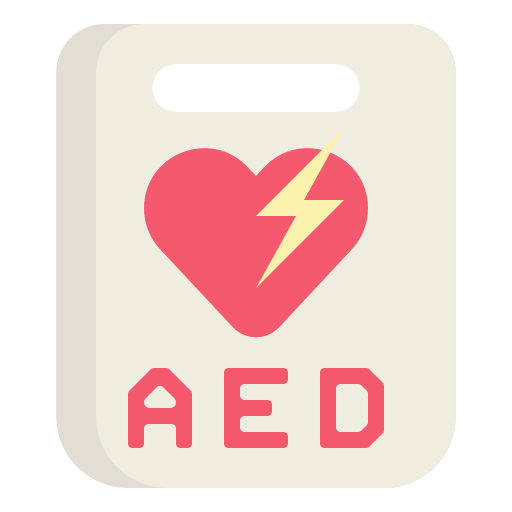
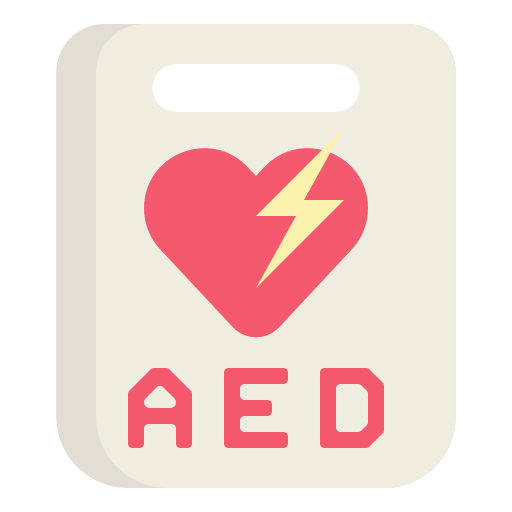
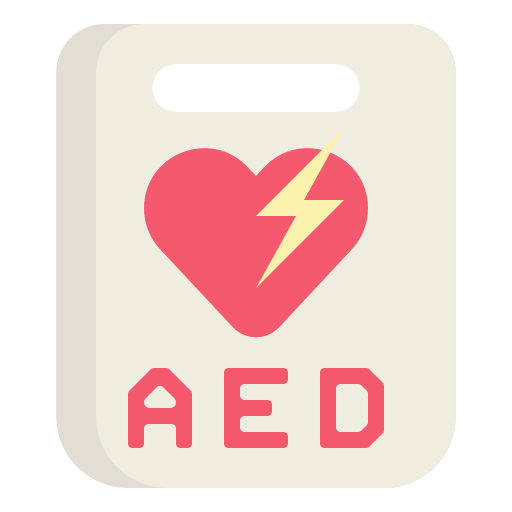
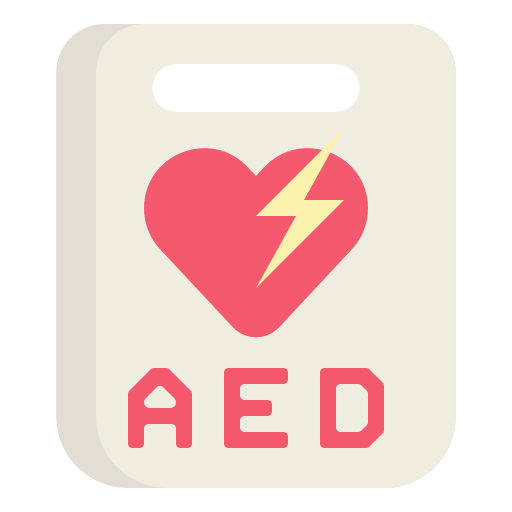
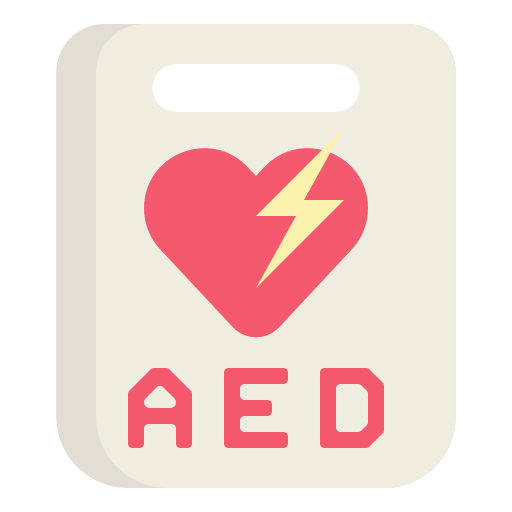
...
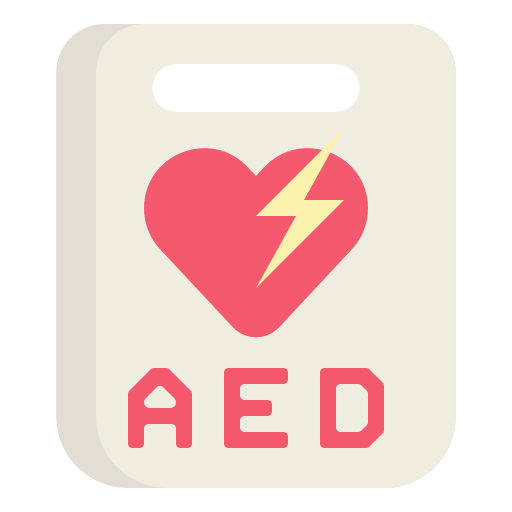
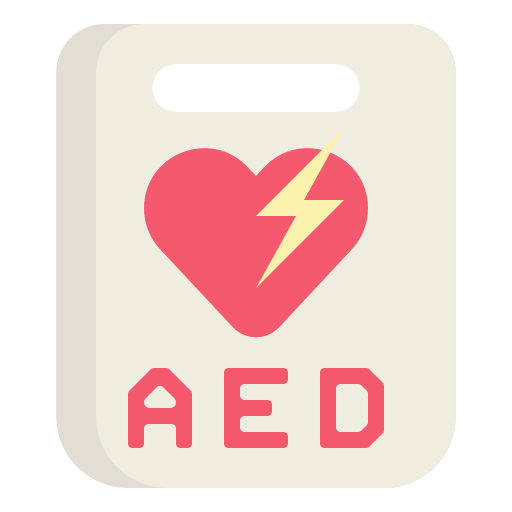
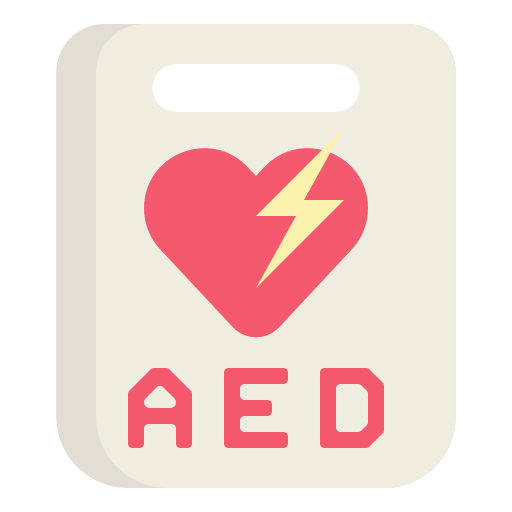
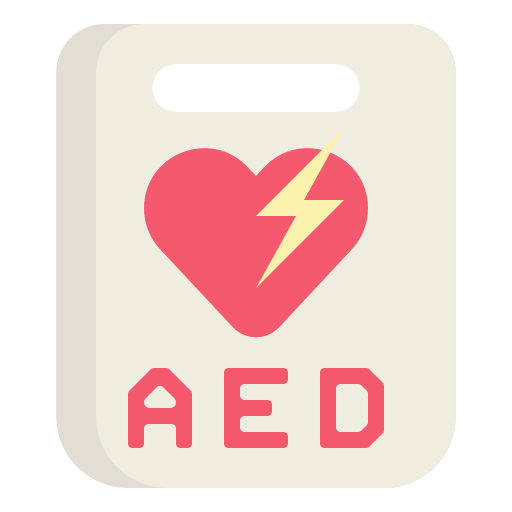
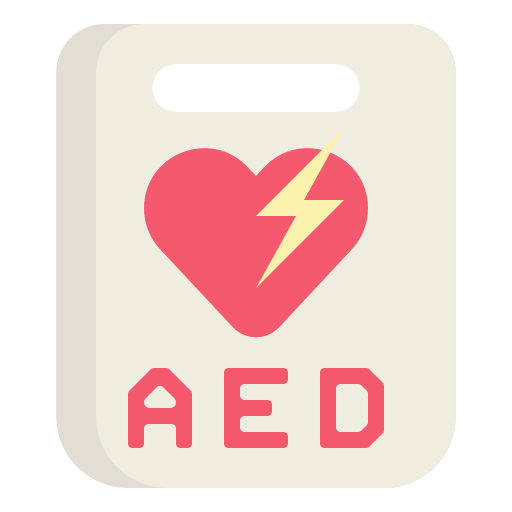

In [12]:
import pydeck as pdk
layer1 = pdk.Layer(
    'PolygonLayer',
    aed_200,
    get_polygon='buffer_200_coordinates',
    get_fill_color= '[216, 157, 227, 89]',
    get_fill_line=[255, 255, 255, 100],
    pickable=True,
    auto_highlight=True)

layer2 = pdk.Layer(
    "IconLayer",
    aed_200,
    get_icon="icon_data",
    get_size=8,
    size_scale=3,
    get_position='[lon, lat]',
    pickable=True,
    auto_highlight=True
)

center = [127.0400, 37.5744]
view_state = pdk.ViewState(
    longitude=center[0],
    latitude=center[1],
    zoom=13)

r = pdk.Deck(layers=[layer1, layer2], initial_view_state=view_state)
r.to_html()

### 4-2) 동대문구 24시간 가동 AED 위치
- 동대문구의 24시간 가동 AED 위치 시각화 및 수요량 생성용 전처리(99 개)
- 사용 데이터 : AED동대문구_24.csv
- 100m buffer는 수요량 b, c를 위해, 200m buffer는 제약조건 1 계산을 위해 생성

In [13]:
aed = pd.read_csv("data/AED동대문구_24.csv", encoding='cp949')

# 수요량 b,c 계산용 100m buffer 생성
aed_24_100 = gpd.GeoDataFrame(aed, geometry=gpd.points_from_xy(aed['경도'], aed['위도']), crs = 'epsg:4326')
aed_24_100 = aed_24_100.set_geometry('geometry')
aed_24_100['buffer_100'] = aed_24_100.to_crs('epsg:5179').buffer(100).to_crs('epsg:4326')
aed_24_100 = aed_24_100.set_geometry('buffer_100')
aed_24_100['buffer_100_coordinates'] = aed_24_100['buffer_100'].apply(polygon_to_coordinates) 

aed_24_100 = aed_24_100[['설치기관주소', '설치위치', '경도', '위도', 'geometry', 'buffer_100', 'buffer_100_coordinates']]
aed_24_100 = aed_24_100.rename(columns = {"경도" : "lon", "위도" : 'lat'})

# 기존 24시간 AED 시각화용 200m buffer 생성 
aed_24_200 = gpd.GeoDataFrame(aed, geometry=gpd.points_from_xy(aed['경도'], aed['위도']), crs = 'epsg:4326')
aed_24_200 = aed_24_200.set_geometry('geometry')
aed_24_200['buffer_200'] = aed_24_200.to_crs('epsg:5179').buffer(200).to_crs('epsg:4326')
aed_24_200 = aed_24_200.set_geometry('buffer_200')
aed_24_200['buffer_200_coordinates'] = aed_24_200['buffer_200'].apply(polygon_to_coordinates)

aed_24_200 = aed_24_200[['설치기관주소', '설치위치', '경도', '위도', 'geometry', 'buffer_200', 'buffer_200_coordinates']]
aed_24_200 = aed_24_200.rename(columns = {"경도" : "lon", "위도" : 'lat'})

aed_24_200['icon_data'] = None
for i in aed_24_200.index:
    aed_24_200["icon_data"][i] = icon_data
aed_24_200

/tmp/ipykernel_10295/1104771356.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  aed_24_200["icon_data"][i] = icon_data


,설치기관주소,설치위치,lon,lat,geometry,buffer_200,buffer_200_coordinates,icon_data
0,서울특별시 동대문구 답십리로56길 105 (답십리동 답십리 파크자이),관리사무실 내,127.058457,37.567790,POINT (127.05846 37.56779),"POLYGON ((127.06072 37.56780, 127.06071 37.567...","[[127.06072157955546, 37.56779858838195], [127...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."
1,서울특별시 동대문구 휘경로 60 (휘경동 휘경SK VIEW 아파트),후문경비초소,127.065445,37.594077,POINT (127.06545 37.59408),"POLYGON ((127.06771 37.59408, 127.06770 37.593...","[[127.06771067802401, 37.594084889241515], [12...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."
2,서울특별시 동대문구 장안벚꽃로5길 19 (휘경동 휘경베스트빌현대아파트),정문 경비실,127.074159,37.582067,POINT (127.07416 37.58207),"POLYGON ((127.07642 37.58208, 127.07641 37.581...","[[127.07642431665644, 37.582075549785976], [12...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."
3,서울특별시 동대문구 왕산로 225 미주상가 A동 (청량리동),미주상가A동 3초소 경비실,127.047209,37.582123,POINT (127.04721 37.58212),"POLYGON ((127.04947 37.58213, 127.04946 37.581...","[[127.04947421016972, 37.58213136693582], [127...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."
4,서울특별시 동대문구 고미술로 93 답십리1 치안센터 (답십리동),출입문 옆,127.056813,37.564664,POINT (127.05681 37.56466),"POLYGON ((127.05908 37.56467, 127.05907 37.564...","[[127.05907718441405, 37.56467242932777], [127...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."
...,...,...,...,...,...,...,...,...
94,서울특별시 동대문구 답십리로 130,보안초소(3초소) 310동,127.052402,37.572857,POINT (127.05240 37.57286),"POLYGON ((127.05467 37.57287, 127.05466 37.572...","[[127.05466723110906, 37.572865145498575], [12...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."
95,서울특별시 동대문구 답십리로 130,노인정앞(108동),127.052402,37.572857,POINT (127.05240 37.57286),"POLYGON ((127.05467 37.57287, 127.05466 37.572...","[[127.05466723110906, 37.572865145498575], [12...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."
96,서울특별시 동대문구 약령시로21길 29 동대문경찰서,유치장 내,127.045794,37.585158,POINT (127.04579 37.58516),"POLYGON ((127.04806 37.58517, 127.04805 37.584...","[[127.04805950168361, 37.58516631467706], [127...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."
97,서울특별시 동대문구 답십리로 210-30 (답십리동 한신아파트),노인정 입구,127.063006,37.571392,POINT (127.06301 37.57139),"POLYGON ((127.06527 37.57140, 127.06526 37.571...","[[127.06527048998456, 37.571400141801256], [12...","{'url': 'data:image/png;base64,iVBORw0KGgoAAAA..."



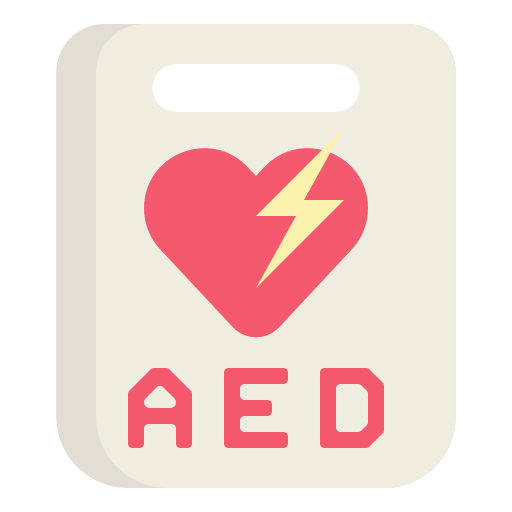
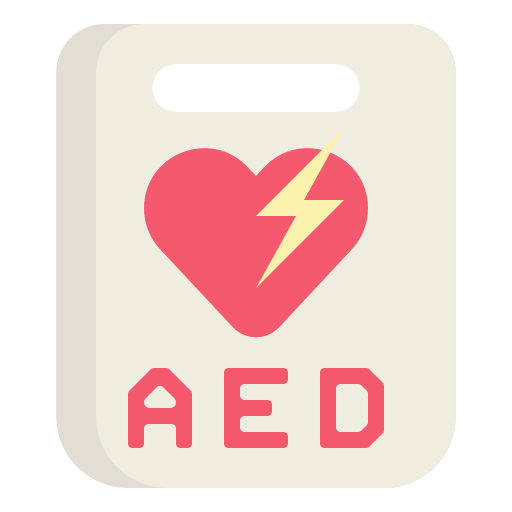
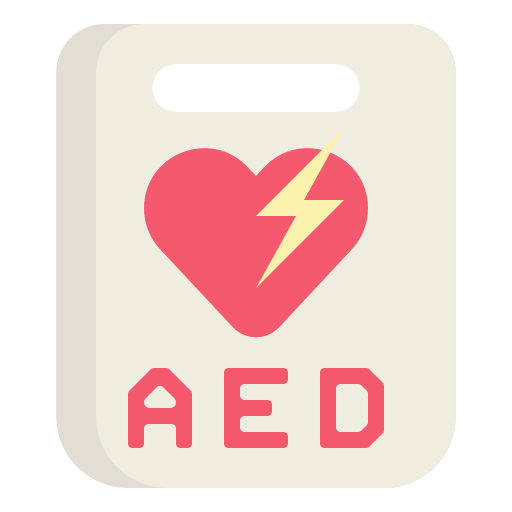
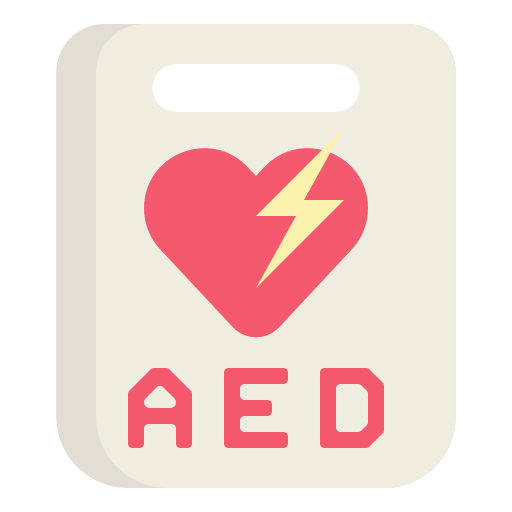
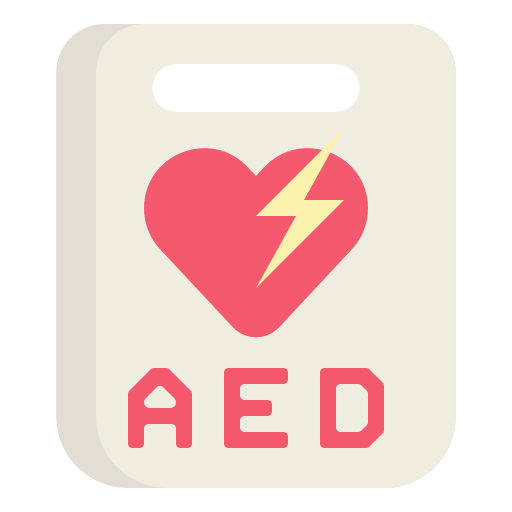
...
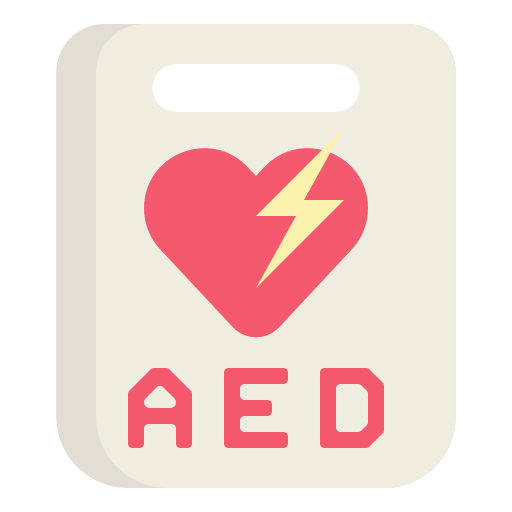
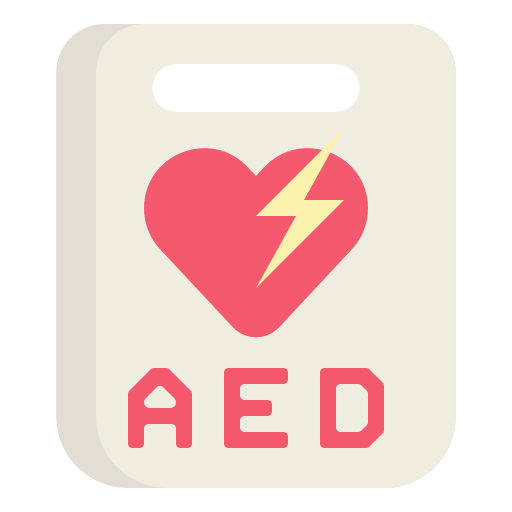
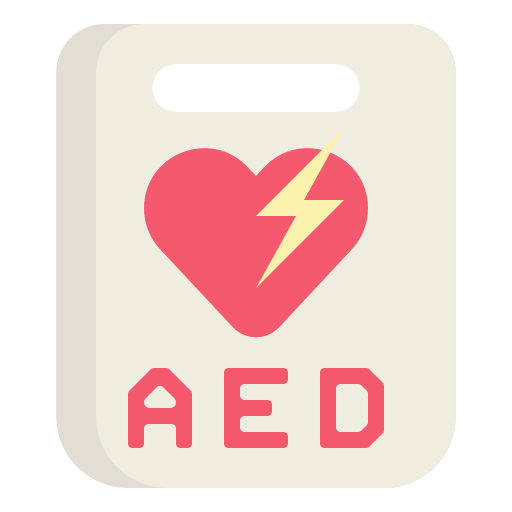
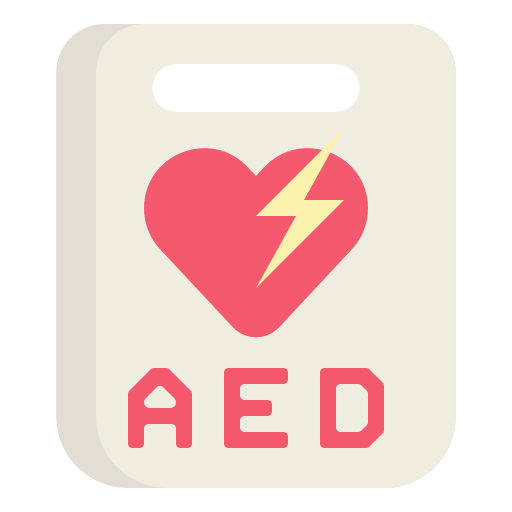
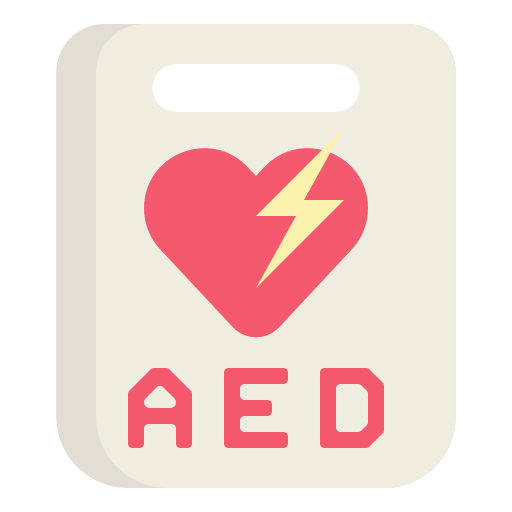

In [14]:
import pydeck as pdk
layer1 = pdk.Layer(
    'PolygonLayer',
    aed_24_200,
    get_polygon='buffer_200_coordinates',
    get_fill_color= '[216, 157, 227, 89]',
    get_fill_line=[255, 255, 255, 100],
    pickable=True,
    auto_highlight=True)

layer2 = pdk.Layer(
    "IconLayer",
    aed_24_200,
    get_icon="icon_data",
    get_size=8,
    size_scale=3,
    get_position='[lon, lat]',
    pickable=True,
    auto_highlight=True
)

center = [127.0400, 37.5744]
view_state = pdk.ViewState(
    longitude=center[0],
    latitude=center[1],
    zoom=13)

r = pdk.Deck(layers=[layer1, layer2], initial_view_state=view_state)
r.to_html('')

## 5. 후보지의 최종적인 수요량 w 생성


### 5-1) 수요량 b,c,w 생성
- b : 후보지가 기존 24시간 AED 유효반경(200m) 내에 존재하는지

- c : 후보지가 기존 24시간 AED와 반경 100m 기준으로 얼마나 겹치는지
- 수요량 b가 0, 1, 2인 후보지만 사용 --> 전체 후보지의 90%에 해당하여 대표성이 충분함
- 반경 200m 이내에 24시간 AED가 3개 이상 있는 point는 추가 설치하기에 부적절하다고 판단하였음

In [15]:
total_list = []   # 결과를 저장할 빈 리스트를 만듭니다.
for i in tqdm(df_dobo_100.index):
    db = df_dobo_100.loc[i, 'buffer_100']
    num = []
    area = []
    for j in aed_24_100.index:
        aed = aed_24_100.loc[j, "buffer_100"]
        num.append(db.intersects(aed))
        if db.intersects(aed) == True:
            area.append(db.intersection(aed).area)
    info = {"intersects_num" : sum(num), "intersects_area" : sum(area)}
    total_list.append(info)  # total_list에 각 info를 추가합니다.

total = pd.DataFrame(total_list)  # 리스트를 DataFrame으로 변환합니다.

# 정규화 및 최종 수요량 산출 
total['intersects_num_scaled'] = (total['intersects_num'].max() - total['intersects_num']) / total['intersects_num'].max()
total['intersects_area_scaled'] = (total['intersects_area'].max() - total['intersects_area']) / total['intersects_area'].max()

df_dobo_200['b'] = total['intersects_num_scaled'].values
df_dobo_200['c'] = total['intersects_area_scaled'].values
df_dobo_200['w'] = 0.4 * df_dobo_200['a'] + 0.3 * df_dobo_200['b'] + 0.3 * df_dobo_200['c']
dobo_full = df_dobo_200.copy()          # 설치 전 전체 커버리지 계산용, 밑에서 필터링 하기때문에 저장 필요 

100%|██████████| 8541/8541 [00:37<00:00, 226.58it/s]


In [16]:
# 수요량 b가 0, 1, 2(정규화 기준 0.75 이상)인 데이터만 사용
# 200m 내에 기존 24시간 AED가 2개 이하로 존재하는 후보지
print(df_dobo_200['b'].value_counts(normalize=True))
print('-------------------------------------------')
print("b=0,1,2 인 후보지가 전체 후보지에서 차지하는 비율 : ", df_dobo_200['b'].value_counts(normalize=True).values[0:3].sum())
print('-------------------------------------------')

df_dobo_200 = df_dobo_200[df_dobo_200['b'] >= 0.75].reset_index(drop=True)
df_dobo_200.head()

1.000    0.513406
0.875    0.275963
0.750    0.116029
0.625    0.035476
0.500    0.019201
0.250    0.013464
0.125    0.010186
0.000    0.008313
0.375    0.007962
Name: b, dtype: float64
-------------------------------------------
b=0,1,2 인 후보지가 전체 후보지에서 차지하는 비율 :  0.9053974944385903
-------------------------------------------


,노드 ID,시군구명,읍면동명,geometry,buffer_200,buffer_200_coordinates,lon,lat,a,b,c,w
0,92202,동대문구,이문동,POINT (127.05837 37.59440),"POLYGON ((127.06064 37.59441, 127.06063 37.594...","[[127.06063695202111, 37.59440832054812], [127...",127.058371,37.594400,0.591425,1.0,1.0,0.836570
1,86075,동대문구,회기동,POINT (127.05407 37.59294),"POLYGON ((127.05634 37.59295, 127.05633 37.592...","[[127.0563372232082, 37.592949665939905], [127...",127.054072,37.592941,0.124781,1.0,1.0,0.649912
2,86074,동대문구,회기동,POINT (127.05425 37.59274),"POLYGON ((127.05652 37.59274, 127.05651 37.592...","[[127.05651538220715, 37.592743613996674], [12...",127.054250,37.592735,0.124781,1.0,1.0,0.649912
3,86069,동대문구,회기동,POINT (127.05374 37.59279),"POLYGON ((127.05601 37.59280, 127.05600 37.592...","[[127.0560063631886, 37.59279649257785], [127....",127.053741,37.592788,0.124781,1.0,1.0,0.649912
4,87176,동대문구,회기동,POINT (127.04950 37.59144),"POLYGON ((127.05176 37.59145, 127.05175 37.591...","[[127.05176111748384, 37.591453352962304], [12...",127.049496,37.591445,0.124781,1.0,1.0,0.649912


### 5-2) 기존 전체 AED 커버리지 계산
- 동대문구에 기존에 존재하던 전체 AED가 커버하는 비율 계산

In [17]:
aed = pd.read_csv("data/자동심장 충격기 정보 조회(AED)(표준 데이터).csv", encoding='cp949')
aed['행정동'] = aed['설치기관주소'].apply(lambda x: x.split()[1])
aed = aed[aed['행정동']=='동대문구'].reset_index(drop=True)

aed_100 = gpd.GeoDataFrame(aed, geometry=gpd.points_from_xy(aed['경도'], aed['위도']), crs = 'epsg:4326')
aed_100 = aed_100.set_geometry('geometry')
aed_100['buffer_100'] = aed_100.to_crs('epsg:5179').buffer(100).to_crs('epsg:4326')
aed_100 = aed_100.set_geometry('buffer_100')
aed_100['buffer_100_coordinates'] = aed_100['buffer_100'].apply(polygon_to_coordinates)

aed_100 = aed_100[['설치기관주소', '설치위치', '경도', '위도', 'geometry', 'buffer_100', 'buffer_100_coordinates']]
aed_100 = aed_100.rename(columns = {"경도" : "lon", "위도" : 'lat'})

aed_100['icon_data'] = None
for i in aed_100.index:
    aed_100["icon_data"][i] = icon_data

# 후보지 반경 200m 내에 존재하는 기존 24시간 AED 수와 겹치는 면적 구하기
full_total_list = []  
for i in tqdm(df_dobo_100.index):
    db = df_dobo_100.loc[i, 'buffer_100']
    num = []
    area = []
    for j in aed_100.index:
        aed = aed_100.loc[j, "buffer_100"]
        num.append(db.intersects(aed))
        if db.intersects(aed) == True:
            area.append(db.intersection(aed).area)
    info = {"intersects_num" : sum(num), "intersects_area" : sum(area)}
    full_total_list.append(info)

full_total = pd.DataFrame(full_total_list)

full_total['intersects_num_scaled'] = (full_total['intersects_num'].max() - full_total['intersects_num']) / full_total['intersects_num'].max()
full_total['intersects_area_scaled'] = (full_total['intersects_area'].max() - full_total['intersects_area']) / full_total['intersects_area'].max()

dobo_full['b'] = full_total['intersects_num_scaled'].values
dobo_full['c'] = full_total['intersects_area_scaled'].values
dobo_full['w'] = 0.4 * dobo_full['a'] + 0.3 * dobo_full['b'] + 0.3 * dobo_full['c']

before_df = pd.concat([dobo_full, full_total], axis=1)
before_df.loc[before_df['intersects_num'] >= 1, "intersects_num"] = 1    # 유효 거리 내에 설치된 경우 1, 아니면 0
before_df['demand'] = before_df['w'] * before_df['intersects_num']       # AED가 유효거리 내에 설치되어 만족된 수요량을 계산 
before_coverage = 100 * round(before_df['demand'].sum() / before_df['w'].sum(), 4)
print('\n------------------------------------------------')
print(f"기존 총 AED 커버리지 : {round(before_coverage,2)} %")


/tmp/ipykernel_10295/1684086860.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  aed_100["icon_data"][i] = icon_data
100%|██████████| 8541/8541 [01:14<00:00, 115.27it/s]



------------------------------------------------
기존 총 AED 커버리지 : 78.14 %


### 5-3) 후보지 수요 히트맵
- 각 후보지의 수요량을 기준으로 그린 히트맵
- 노란색에서 빨간색으로 갈수록 수요가 작아 AED 설치 필요성이 적어짐
- 빨간색 지역은 적고 노란색 지역이 많아 AED 설치가 우선적으로 필요한 지역을 알 수 있음
- 청량리동, 회기동, 용신동은 비교적 필요성이 떨어지고 장안동과 답십리동에 필요성이 큼


In [ ]:
heatmap_df = pd.DataFrame(dobo_full[['노드 ID', 'geometry', 'lon', 'lat', 'w']])

layer = pdk.Layer(
    'ScatterplotLayer',
    heatmap_df,
    get_position='[lon, lat]',
    get_radius=20,
    get_fill_color='[255, 255 * w, 0]',
    opacity = 0.5,
    pickable=True,
    auto_highlight=True)

# boundary layer 
boundary_layer = pdk.Layer(
    'PolygonLayer',
    boundary,
    get_polygon = 'coordinates',
    get_fill_color = '[128, 128, 128]',
    get_line_color = '[0,255,0]',
    lineWidthScale = 20,
    pickable = True,
    auto_highlight = True,
    opacity = 0.05
)

center = [127.0400, 37.5744]
view_state = pdk.ViewState(
    longitude=center[0],
    latitude=center[1],
    zoom=13)

r = pdk.Deck(layers=[boundary_layer, layer], initial_view_state=view_state)
r.to_html('')

In [19]:
aed_24_100.to_csv('./data/aed_24_100.csv', index=False)
aed_24_200.to_csv('./data/aed_24_200.csv', index=False)
df_dobo_100.to_csv('./data/df_dobo_100.csv', index=False)
df_dobo_200.to_csv('./data/df_dobo_200.csv', index=False)
total.to_csv('./data/total.csv', index=False)